In [1]:
from pathlib import Path

In [2]:
import cv2
import numpy as np
import pandas as pd

In [3]:
from PIL import Image
from IPython.display import display

def show(ary):
    display(Image.fromarray(ary))

In [ ]:
images = sorted(Path('/home/jiun/datasets/amano/cylinder/refine-annot/train/images').glob('*.jpg'))
g = Path('/home/jiun/datasets/amano/cylinder/refine-annot/train/annotations')
d = Path('/home/jiun/datasets/weights/train-self/vgg16-step-20-voc/pseudo/00071694')
save = None

In [6]:
images = sorted(Path('/home/jiun/datasets/amano/200203/b2-35').glob('*.jpg'))
g = None
d = Path('/home/jiun/datasets/amano/200203/results/b2-35-vgg16')
save = None

In [17]:
images = sorted(Path('/home/jiun/datasets/amano/nvr-warp/test/images').glob('*.jpg'))
g = Path('/home/jiun/datasets/amano/nvr-warp/test/annotations')
d = Path('/home/jiun/datasets/amano/nvr-warp/results/ssd-vgg16')
save = None

In [8]:
images = sorted(Path('/home/jiun/datasets/amano/cylinder/refine-annot/test/images').glob('*.jpg'))
g = Path('/home/jiun/datasets/amano/cylinder/refine-annot/test/annotations')
d = Path('/home/jiun/datasets/amano/cylinder/refine-annot/results/eff0')
save = None

In [ ]:
images = sorted(Path('test-results').glob('*.jpg'))
d = Path('test-detection')
g = None
save = Path('test-save')
save.mkdir(exist_ok=True)

/home/jiun/datasets/amano/nvr-warp/test/images/nvr001_01_01_CT_20190110075017+1.jpg


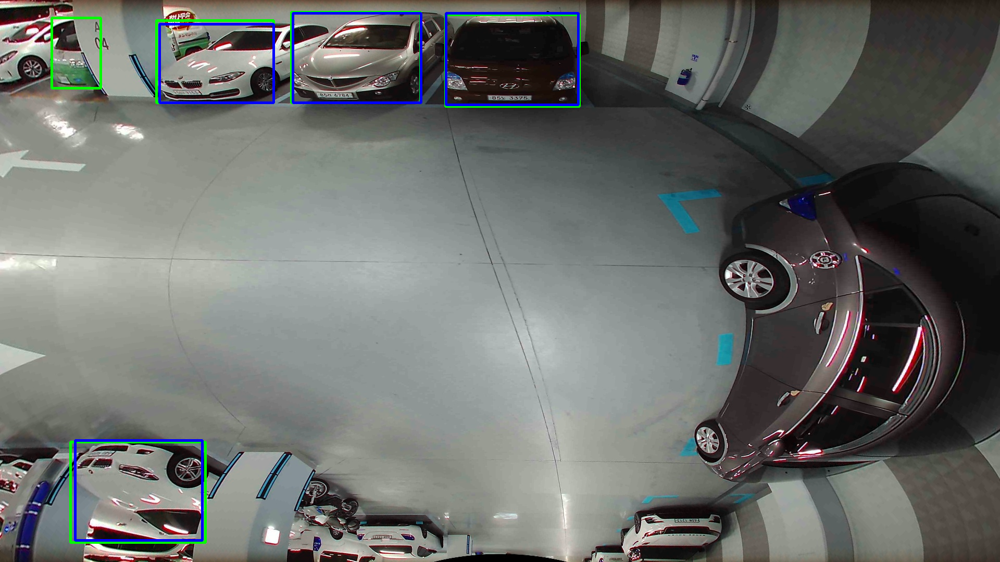

/home/jiun/datasets/amano/nvr-warp/test/images/nvr001_09_09_CT_20190112115022+1.jpg


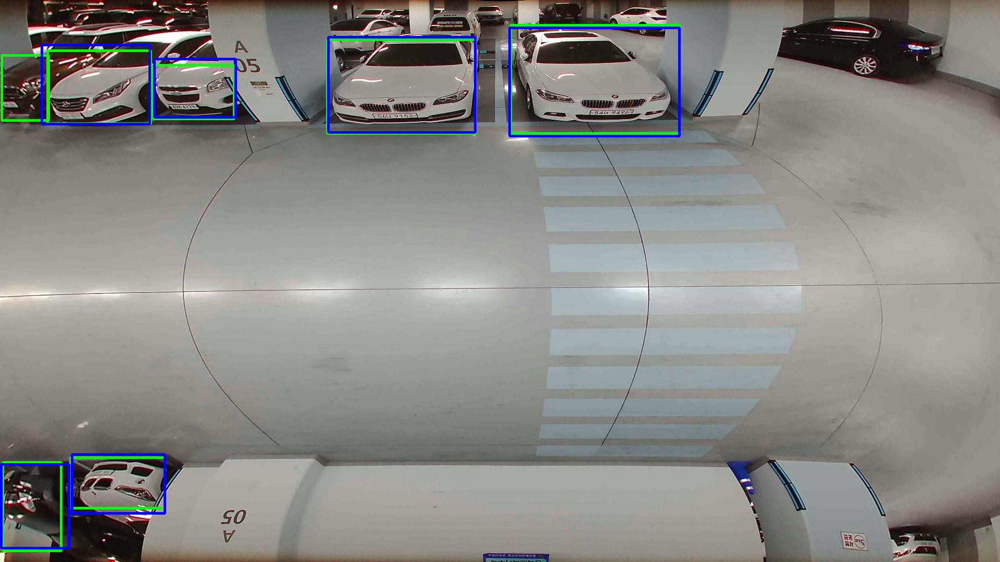

/home/jiun/datasets/amano/nvr-warp/test/images/nvr001_18_18_CT_20190111015011+1.jpg


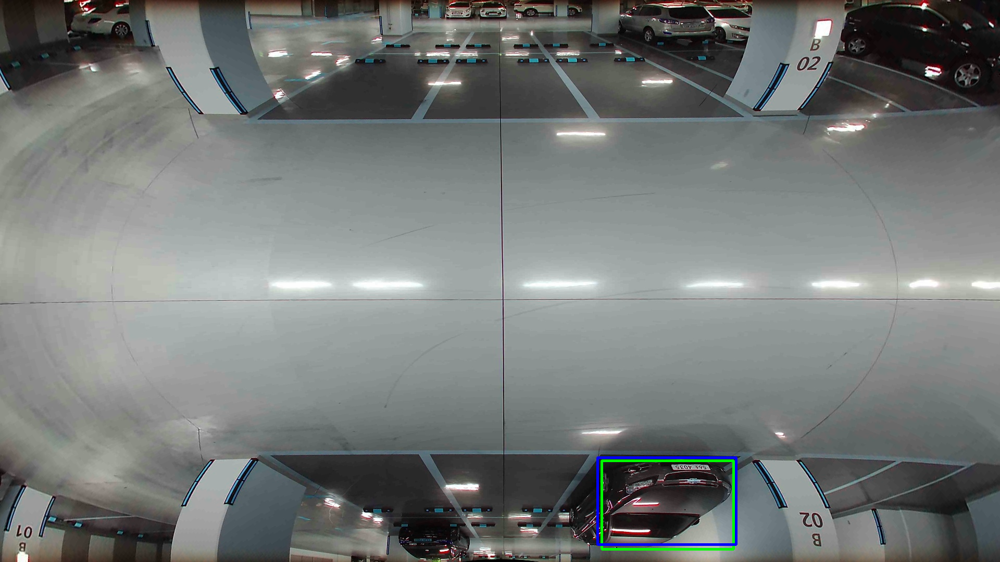

/home/jiun/datasets/amano/nvr-warp/test/images/nvr001_27_27_CT_20190110115006+1.jpg


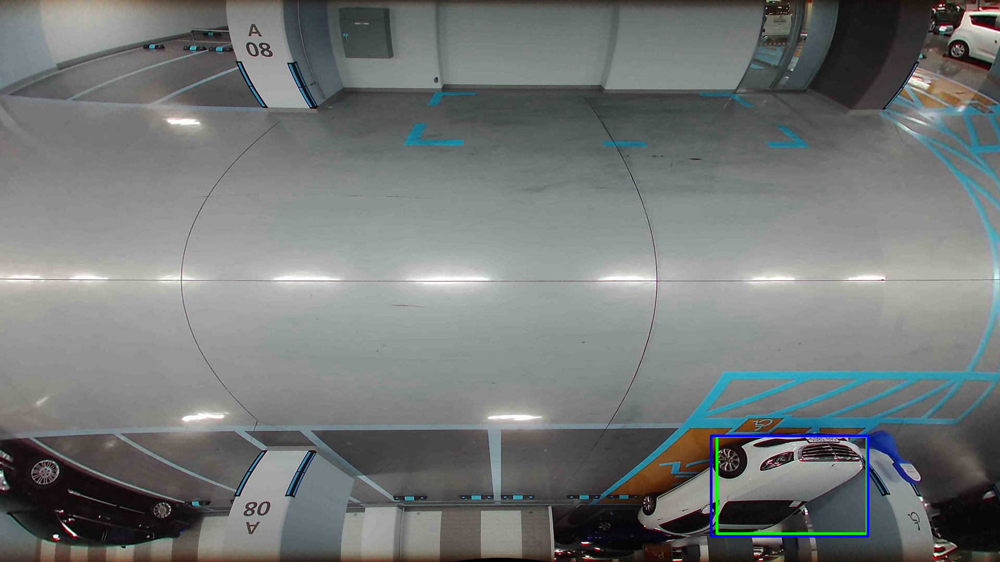

/home/jiun/datasets/amano/nvr-warp/test/images/nvr002_01_01_CT_20190112085010+1.jpg


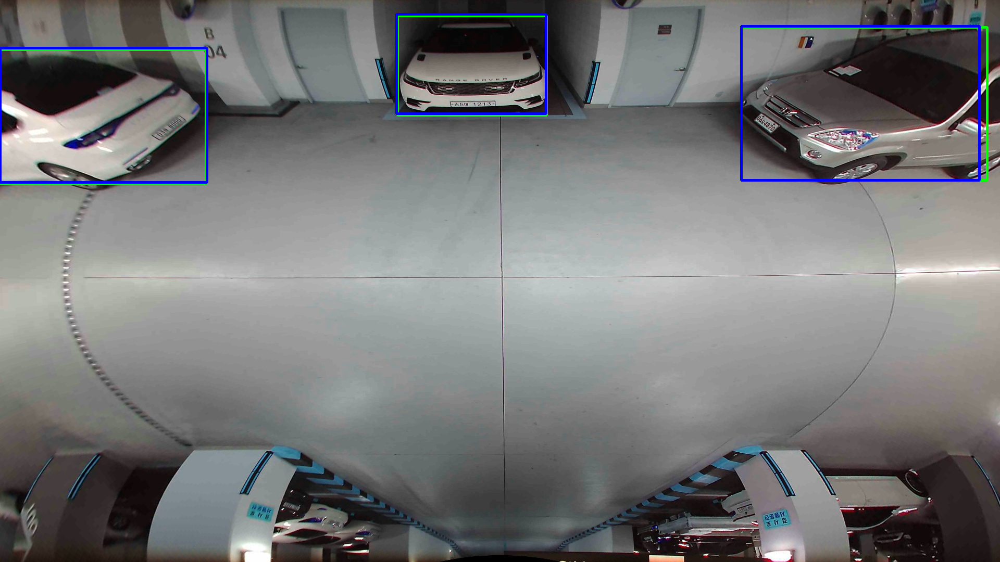

/home/jiun/datasets/amano/nvr-warp/test/images/nvr002_06_06_CT_20190110095009+1.jpg


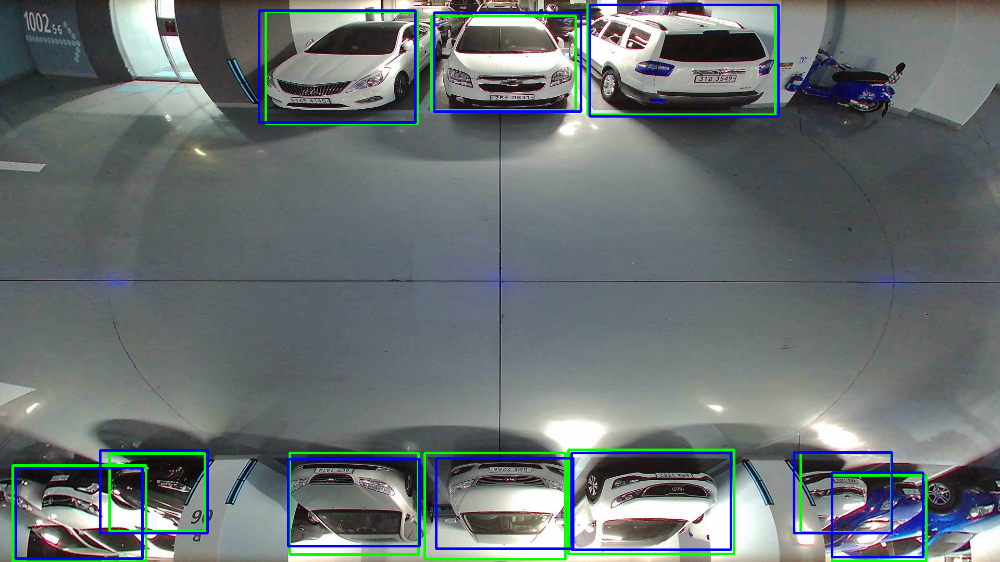

/home/jiun/datasets/amano/nvr-warp/test/images/nvr002_10_10_CT_20190112055021+1.jpg


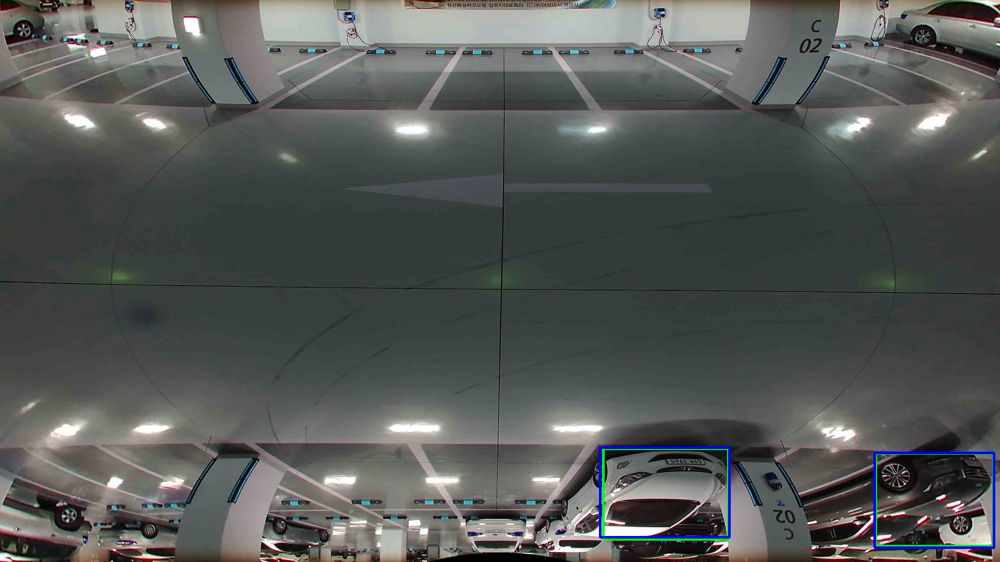

/home/jiun/datasets/amano/nvr-warp/test/images/nvr002_14_14_CT_20190112045016+1.jpg


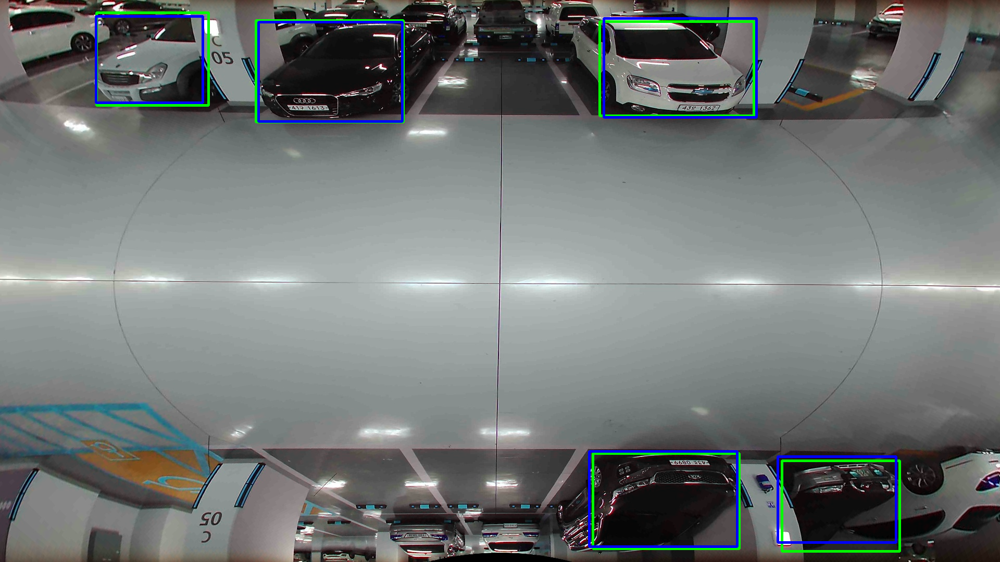

/home/jiun/datasets/amano/nvr-warp/test/images/nvr002_18_18_CT_20190112045005+1.jpg


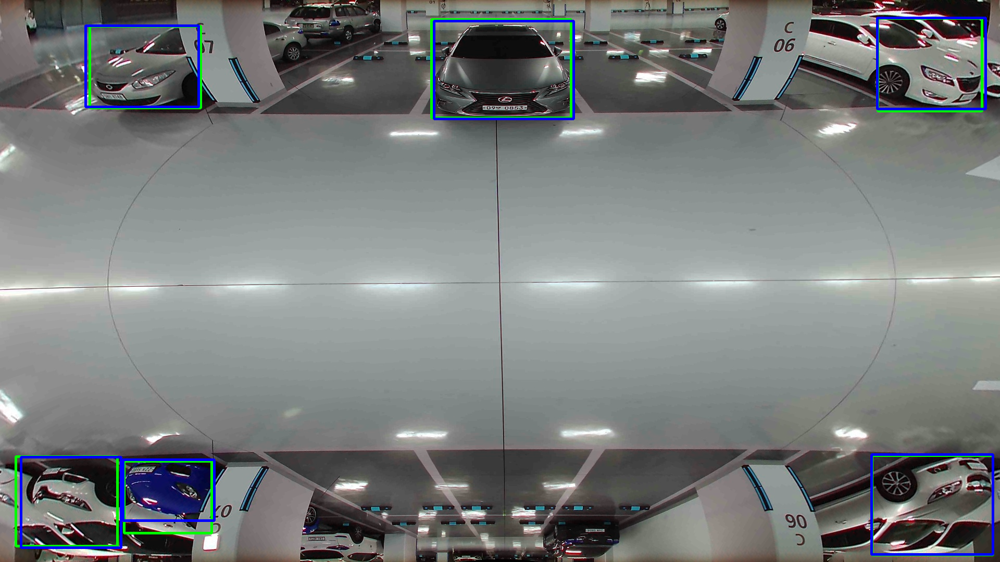

/home/jiun/datasets/amano/nvr-warp/test/images/nvr002_23_23_CT_20190110035010+1.jpg


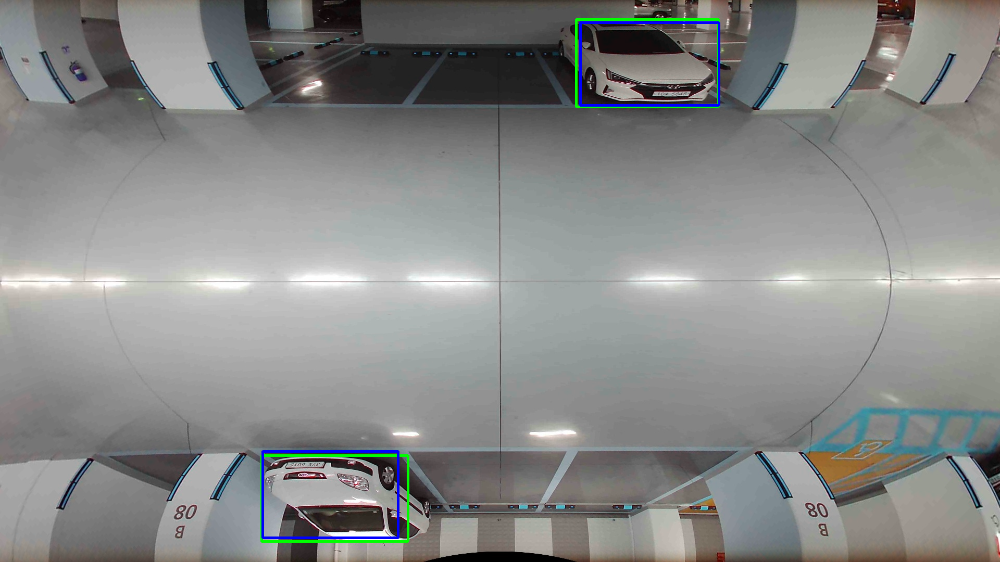

/home/jiun/datasets/amano/nvr-warp/test/images/nvr002_27_27_CT_20190112075006+1.jpg


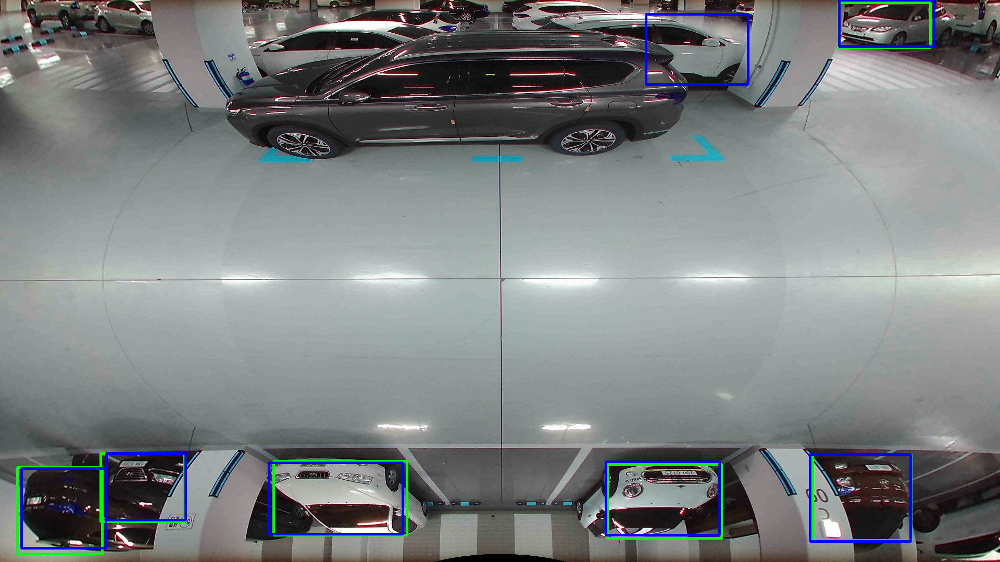

/home/jiun/datasets/amano/nvr-warp/test/images/nvr011_01_01_CT_20190112075016+1.jpg


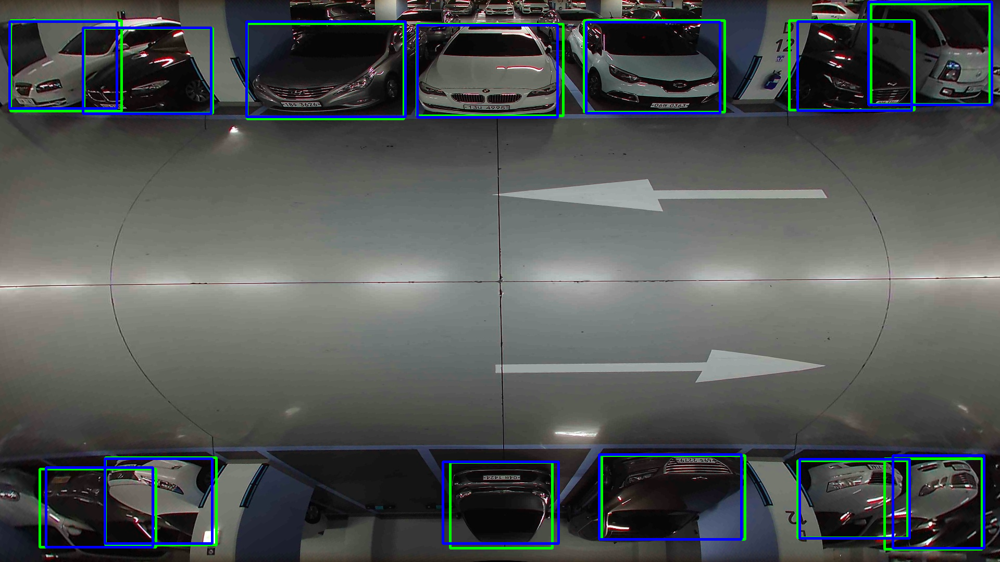

In [34]:
for image in images[::32]:
    img = cv2.imread(str(image))
    
#     seq, idx, *fix = image.stem.split('_')
#     dname = '_'.join((seq, idx, idx, *fix))
    dname = image.stem
    hh, ww, *_ = img.shape
    try:
        gt = g.joinpath(f'{image.stem}.txt')
        get = pd.read_csv(str(gt), header=None).values
        for x, y, w, h in get:
            cv2.rectangle(img, (int(x), int(y)), (int(w), int(h)), (0, 255, 0), 3)
    except:
        pass
    
    try:
        detection = d.joinpath(f'{dname}.txt')
        det = pd.read_csv(str(detection), header=None).values
        for klass, conf, x, y, w, h in det:
            if conf > .9:
                cv2.rectangle(img, (int(x*ww), int(y*hh)), (int(w*ww), int(h*hh)), (0, 0, 255), 3)
    except:
        continue
    
    if save is not None:
        cv2.imwrite(str(save.joinpath(image.name)), img)
    
    print(image)
    show(img)
    if str(image) == "/home/jiun/datasets/amano/nvr-warp/test/images/nvr011_01_01_CT_20190112075016+1.jpg":
        break

In [35]:
cv2.imwrite('warped-result.jpg', img)

True

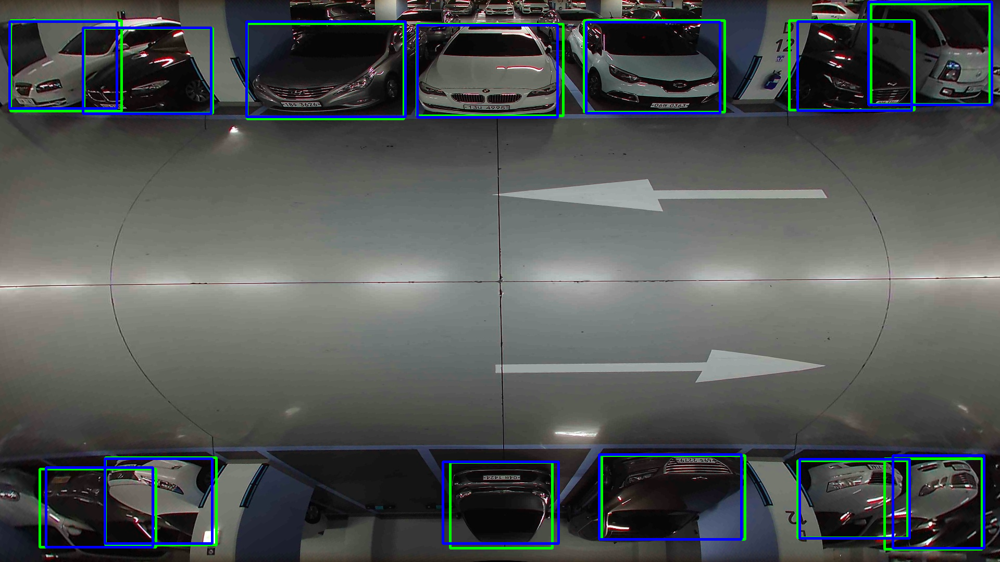

In [36]:
show(img)

In [37]:
!pwd

/home/jiun/workspace/SSD/labs
